<a href="https://colab.research.google.com/github/WeAreDobby/CV_project/blob/main/GAN/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Google Drive 연동
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from IPython import display
from tqdm.notebook import tqdm

import tensorflow_probability as tfp
import tensorflow as tf

import matplotlib.pyplot as plt
import numpy as np
import os, glob, imageio, PIL, time

In [ ]:
# Hyper Parameter
EPOCHS = 1000
channel = 1
image_size = 128
latent_size = 100  #latent vector size
batch_size = 512
learning_rate = 0.0001
read_type = lambda channel: 'rgb' if channel==3 else 'gray'

In [ ]:
# Load Pocketmon Dataset
def find_path(path):
    file_list = os.listdir(path)
    return file_list

def png_to_np(file_name, read_type='rgb'):
    if read_type == "rgb":
      image = PIL.Image.open(file_name) # (256, 256, 3)
    elif read_type == "gray":
      image = PIL.Image.open(file_name).convert("L") # (256, 256, 1)

    return (np.array(image).astype(np.float32) - 127.5) / 127.5

In [ ]:
#데이터셋 받는부분 / Image를 그냥 받을때
path = 'drive/MyDrive/dataset/Human/Human_{}'.format(str(image_size))  # 'drive/MyDrive/dataset/Dobby/Dobby_{}' #'drive/MyDrive/dataset/pockemon/jpg/jpg_dataset_{}'
file_list = find_path(path)

images = []
for idx, file in tqdm(enumerate(file_list), desc="loading dataset"):
  file_name = path + '/' + file
  image = png_to_np(file_name, read_type=read_type(channel))
  images.append(image)

train_dataset = np.array(images)

OSError: ignored

In [ ]:
# 데이터가 너무 클때 numpy 데이터 통채로 저장
np.save('drive/MyDrive/dataset/human_array.npy', train_dataset)
print("human data is saved")

In [ ]:
# 저장되어있는 npy파일 불러오기
train_dataset = np.load('drive/MyDrive/dataset/Human/human_array_128.npy')
train_dataset.shape

(97671, 128, 128)

In [ ]:
# GrayScale일때 1channel을 만들어주기위해 활용
if channel == 1:
  train_dataset = train_dataset[..., tf.newaxis]
  
train_dataset = (tf.data.Dataset.from_tensor_slices(train_dataset)
                 .shuffle(30).batch(batch_size))

In [ ]:
# DCGAN
# Generator
class Generator(tf.keras.Model):
  def __init__(self):
    super(Generator, self).__init__()
    dense = tf.keras.layers.Dense
    conv2d_t = tf.keras.layers.Conv2DTranspose
    batchNormalization = tf.keras.layers.BatchNormalization
    reshape = tf.keras.layers.Reshape
    leakyrelu = tf.keras.layers.LeakyReLU()

    self.sequence = list()
    # Block 1
    self.sequence.append(dense(image_size/8 * image_size/8 * 128 , activation=leakyrelu))                      # 128 기준 16
    self.sequence.append(batchNormalization())
    self.sequence.append(reshape((int(image_size/8), int(image_size/8), 128)))

    # Block 2
    self.sequence.append(conv2d_t(64, (5, 5), strides=(2, 2), padding='same', activation=leakyrelu))           #32      
    self.sequence.append(batchNormalization())

    # Block 3
    self.sequence.append(conv2d_t(16, (5, 5), strides=(2, 2), padding='same', activation=leakyrelu))            #64
    self.sequence.append(batchNormalization())

    # Block 4
    self.sequence.append(conv2d_t(1, (5, 5), strides=(2, 2), padding='same', activation='tanh'))                #128

  def call(self, z):
    for layer in self.sequence:
      z = layer(z)

    return z

# Discriminator
class Discriminator(tf.keras.Model):
  def __init__(self):
    super(Discriminator, self).__init__()
    conv2d = tf.keras.layers.Conv2D
    maxpool = tf.keras.layers.MaxPool2D
    dense = tf.keras.layers.Dense
    flatten = tf.keras.layers.Flatten
    leakyrelu = tf.keras.layers.LeakyReLU()

    self.sequence = list()
    # Block 1
    self.sequence.append(conv2d(8, kernel_size=(3, 3), activation=leakyrelu, padding="same"))  
    self.sequence.append(maxpool((2, 2)))                            

    # Block 2
    self.sequence.append(conv2d(32, kernel_size=(3, 3), activation=leakyrelu, padding="same"))
    self.sequence.append(maxpool((2, 2)))

    # Block 3
    self.sequence.append(conv2d(64, kernel_size=(3, 3), activation=leakyrelu, padding="same"))
    self.sequence.append(maxpool((2, 2)))

    # Block 4
    self.sequence.append(conv2d(128, kernel_size=(3, 3), activation=leakyrelu, padding="same"))
    self.sequence.append(flatten())

    # Block 5
    self.sequence.append(dense(1024, activation=leakyrelu))
    self.sequence.append(dense(1))
    
  def call(self, x):
    for layer in self.sequence:
      x = layer(x)

    return x

In [ ]:
# Noise 생성부
def make_noises(batch_size, latent_size):
  return tf.random.normal((batch_size, latent_size), dtype=tf.float32)
  
# D_Model Loss 연산
def discriminator_loss(loss, d_result_real, d_result_fake):
    real_loss = loss(tf.ones_like(d_result_real), d_result_real)
    fake_loss = loss(tf.zeros_like(d_result_fake), d_result_fake)
    total_loss = real_loss + fake_loss
    return total_loss

# D_Model Optimizer
def discriminator_optimizer(learning_rate):
    return tf.keras.optimizers.Adam(learning_rate)

# G_Model Loss 연산
def generator_loss(loss, d_result_fake):
    return loss(tf.ones_like(d_result_fake), d_result_fake)

# G_Model Optimizer
def generator_optimizer(learning_rate):
    return tf.keras.optimizers.Adam(learning_rate)

# G_Model에서 생성된 이미지 저장하는거
def generate_and_save_images(g_model, batch_size, latent_size, epoch):
  noises = make_noises(batch_size, latent_size)
  g_predict = g_model(noises, training=False)

  fig = plt.figure(figsize=(20, 20))
  for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow(g_predict[i, :, :, 0], cmap='gray')
    plt.axis('off')
  plt.axis('off')

  #plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

def show_losses(g_losses, d_losses, epoch):
  plt.figure(figsize=(6,3))
  plt.plot(g_losses, '.-r', label='G_LOSS')
  plt.plot(d_losses, '.-b', label='D_LOSS')
  plt.title("g_loss, d_loss Epoch : {}".format(epoch))
  plt.xlabel("Epochs")
  plt.ylabel("Losses")
  plt.legend()
  plt.show()

@tf.function
def train_step(g_model, d_model, loss_function, g_optimizer, d_optimizer, learning_rate, real_images):
  noises = make_noises(batch_size, latent_size)

  with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
    g_images = g_model(noises)

    d_result_real = d_model(real_images, training=True)
    d_result_fake = d_model(g_images, training=True)

    g_loss = generator_loss(loss_function, d_result_fake)
    d_loss = discriminator_loss(loss_function, d_result_real, d_result_fake)

  g_gradients = g_tape.gradient(g_loss, g_model.trainable_variables)
  d_gradients = d_tape.gradient(d_loss, d_model.trainable_variables)

  g_optimizer.apply_gradients(zip(g_gradients, g_model.trainable_variables))
  d_optimizer.apply_gradients(zip(d_gradients, d_model.trainable_variables))

  return g_loss, d_loss

In [ ]:
g_model = Generator()
d_model = Discriminator()

loss_function = tf.keras.losses.BinaryCrossentropy(from_logits=True)

g_optimizer = generator_optimizer(learning_rate)
d_optimizer = discriminator_optimizer(learning_rate)

checkpoint_dir = 'drive/MyDrive/model_ckpt/DCGAN'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=g_optimizer,
                                 discriminator_optimizer=d_optimizer,
                                 generator=g_model,
                                 discriminator=d_model)

Train Epoch:   0%|          | 0/1000 [00:00<?, ?it/s]

Train Step: 0it [00:00, ?it/s]

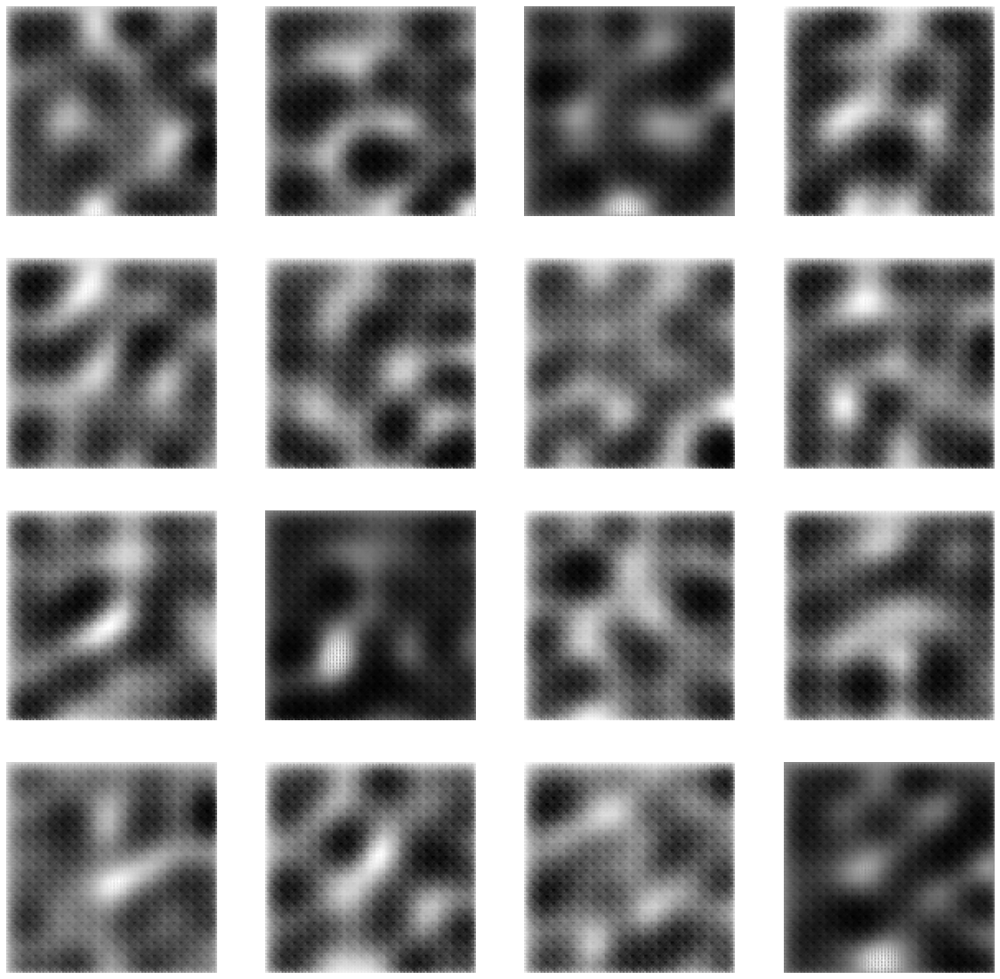

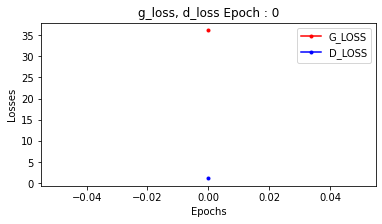

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

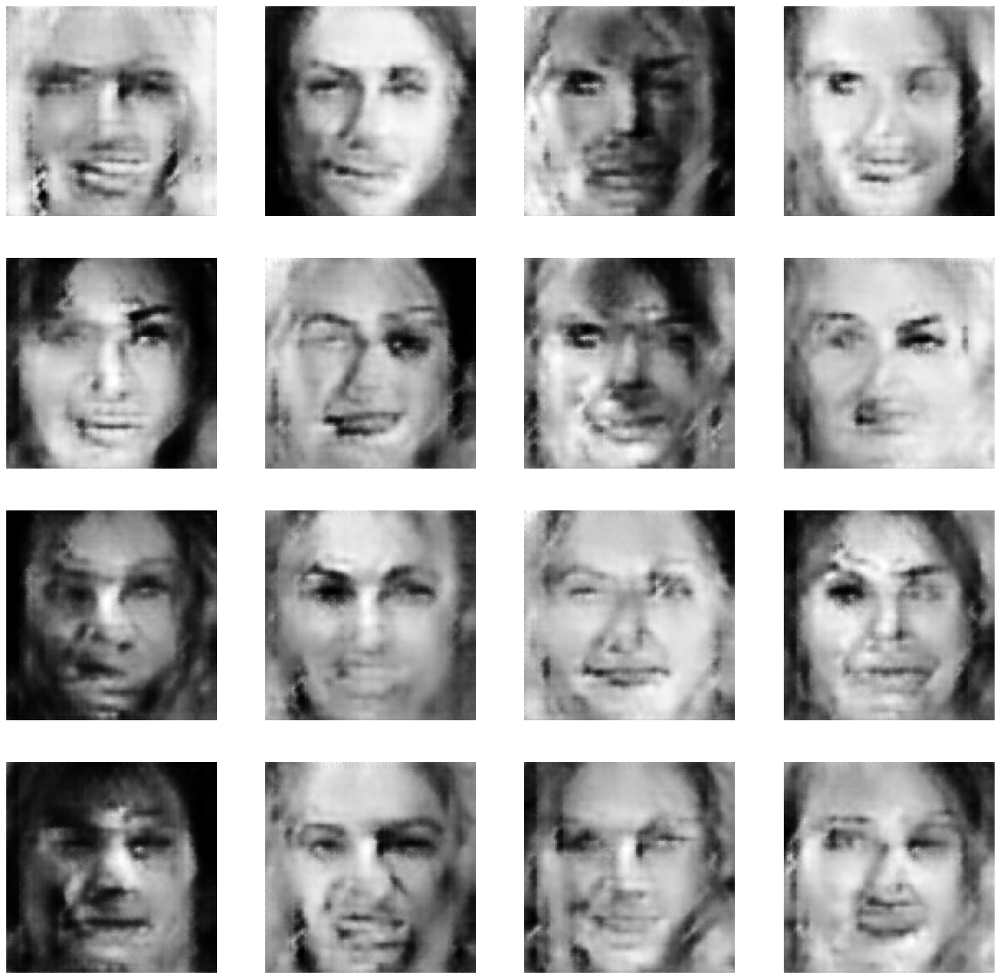

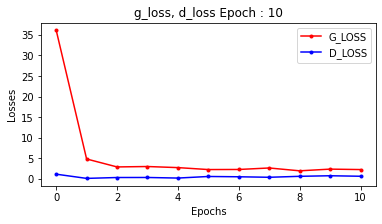

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

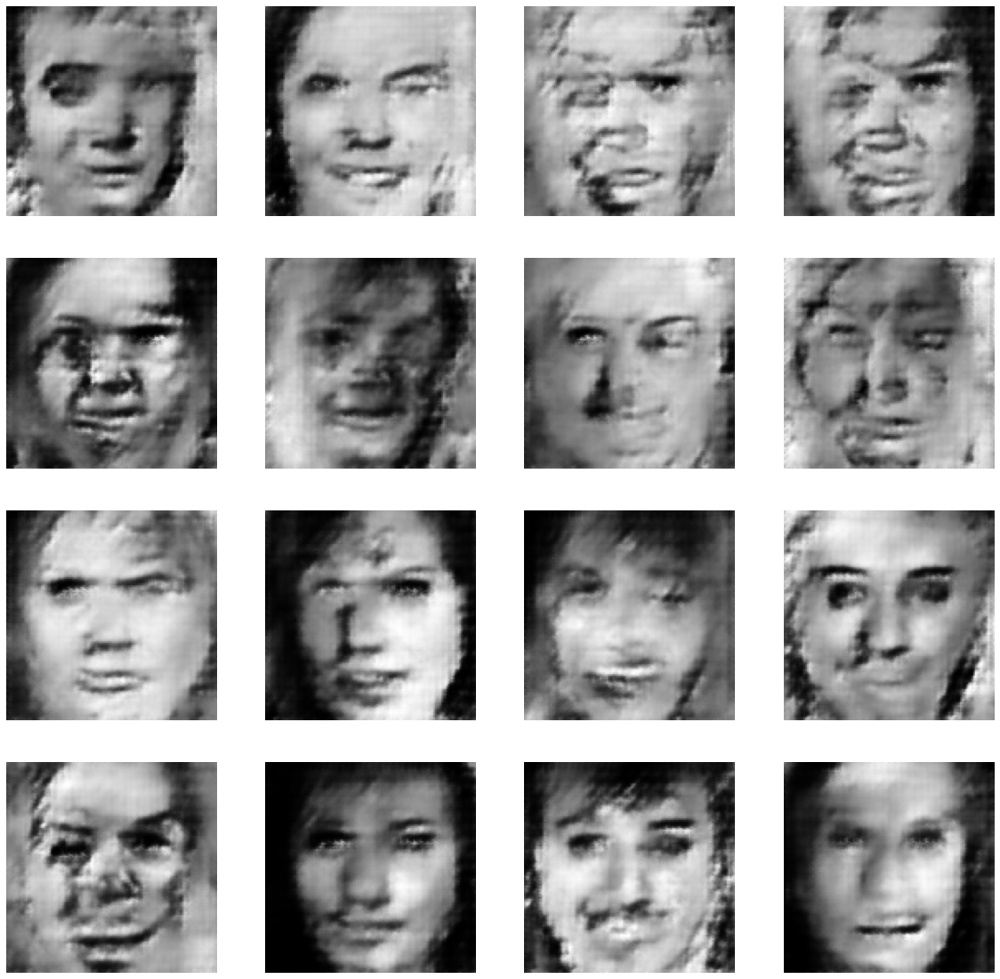

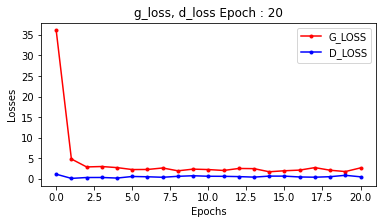

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

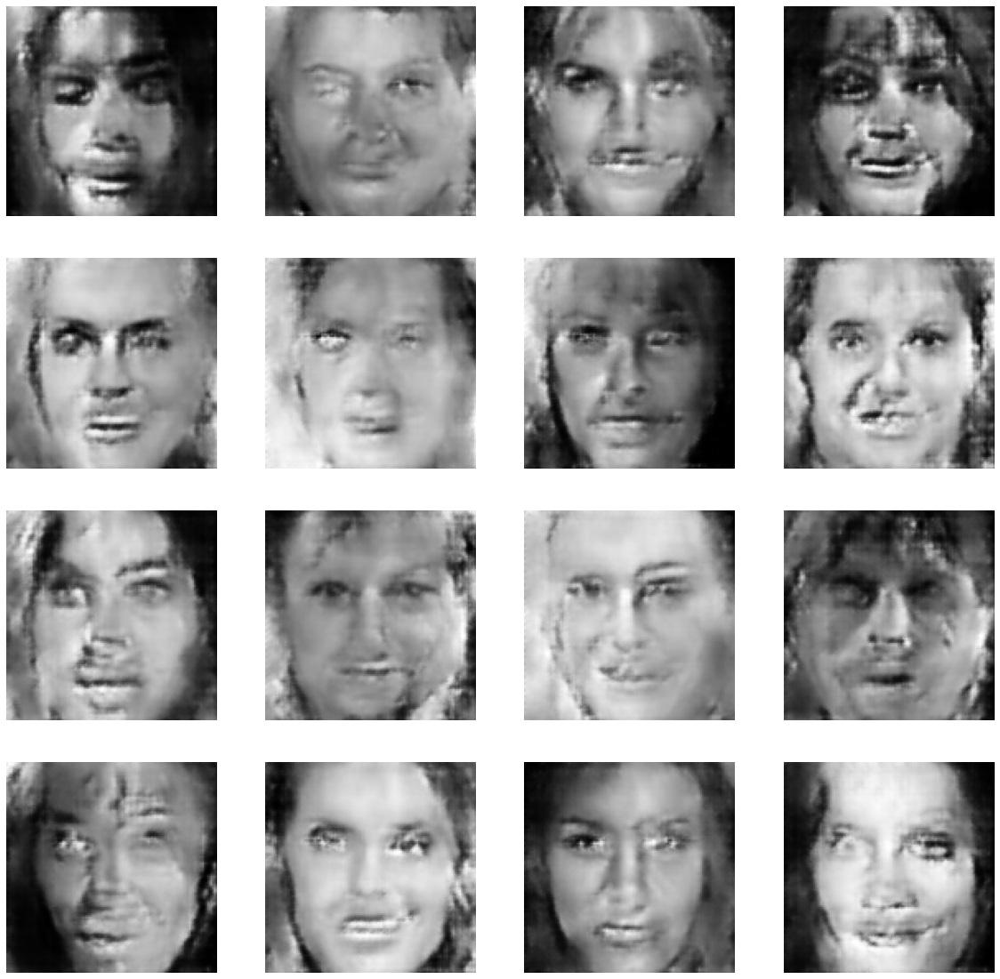

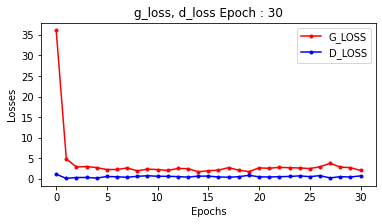

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

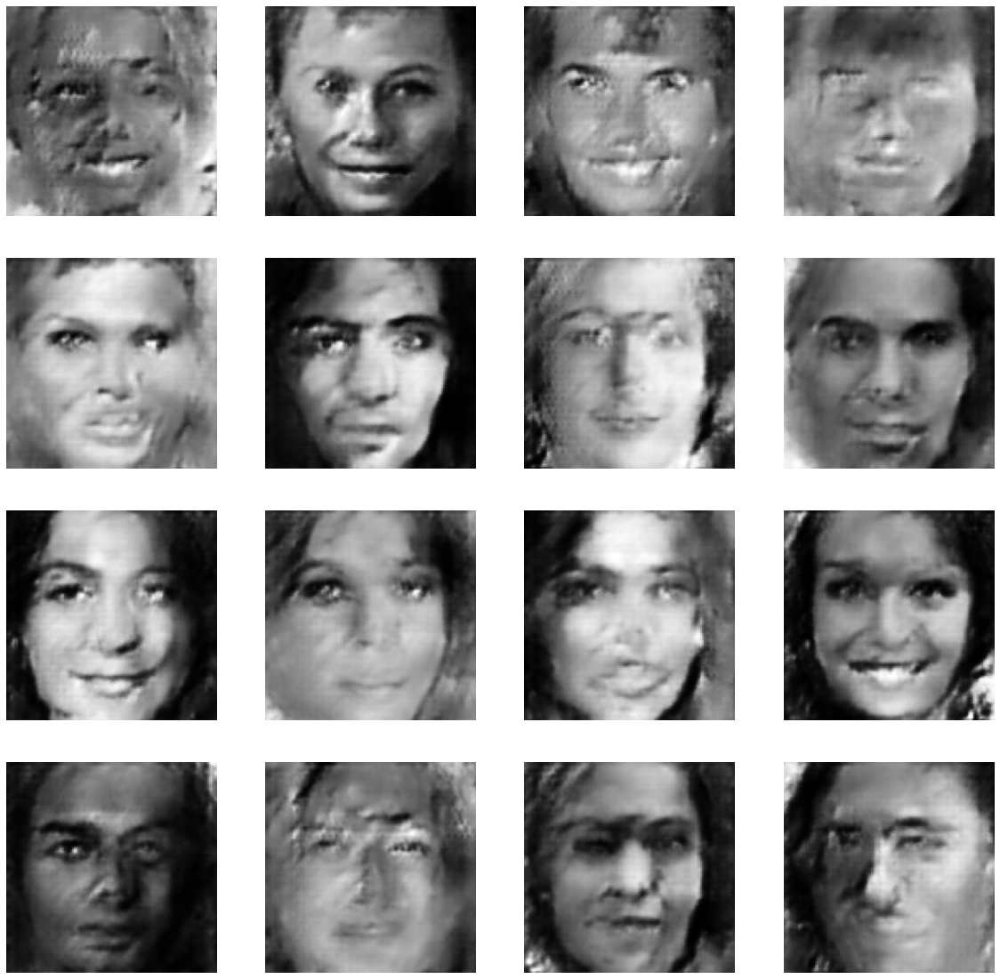

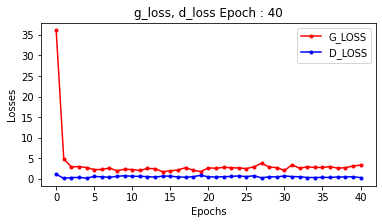

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

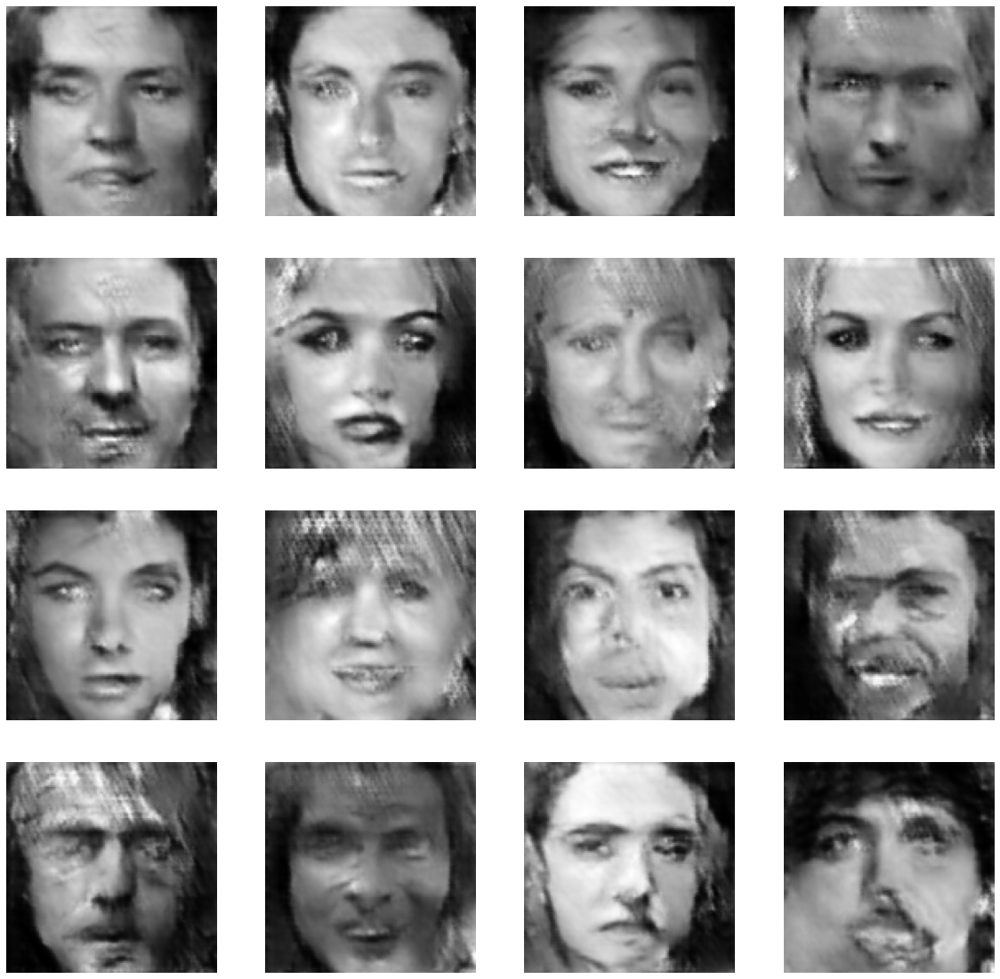

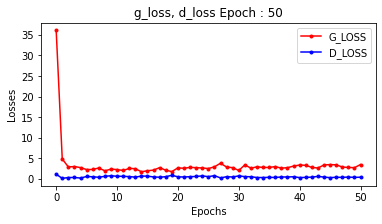

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

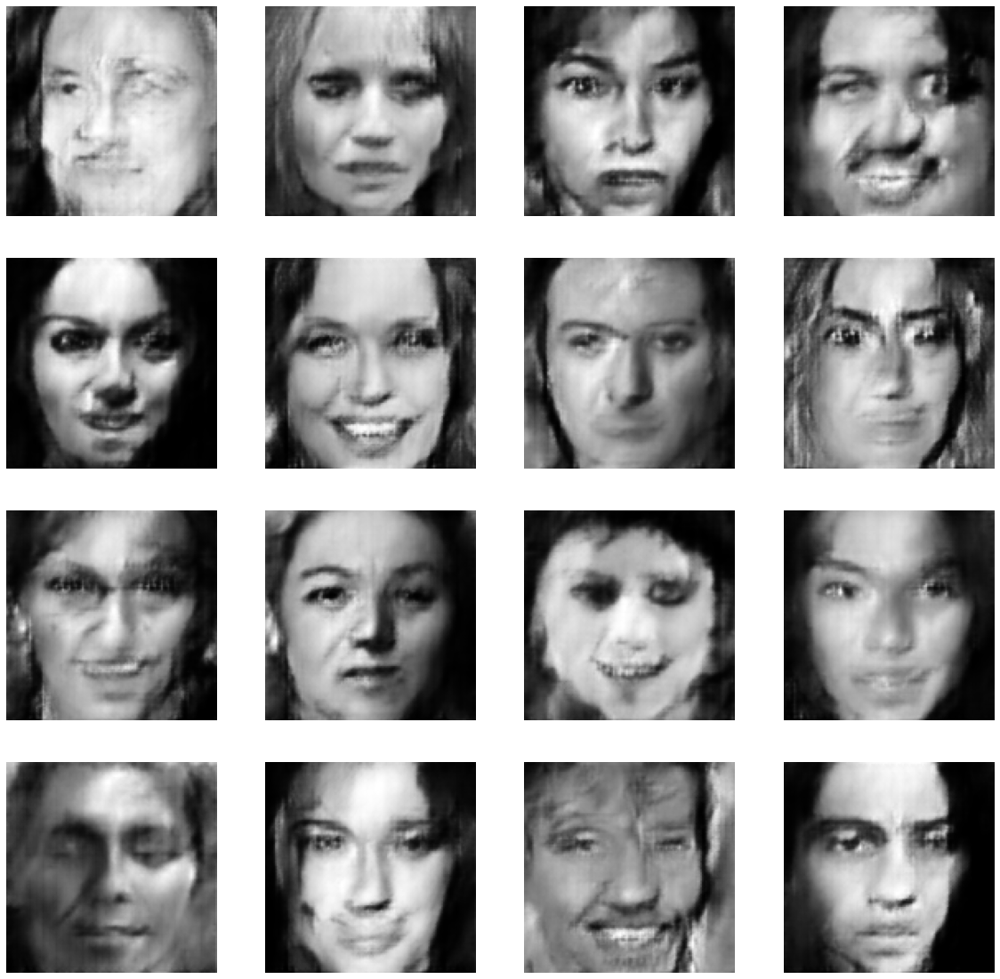

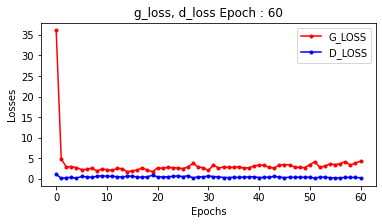

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

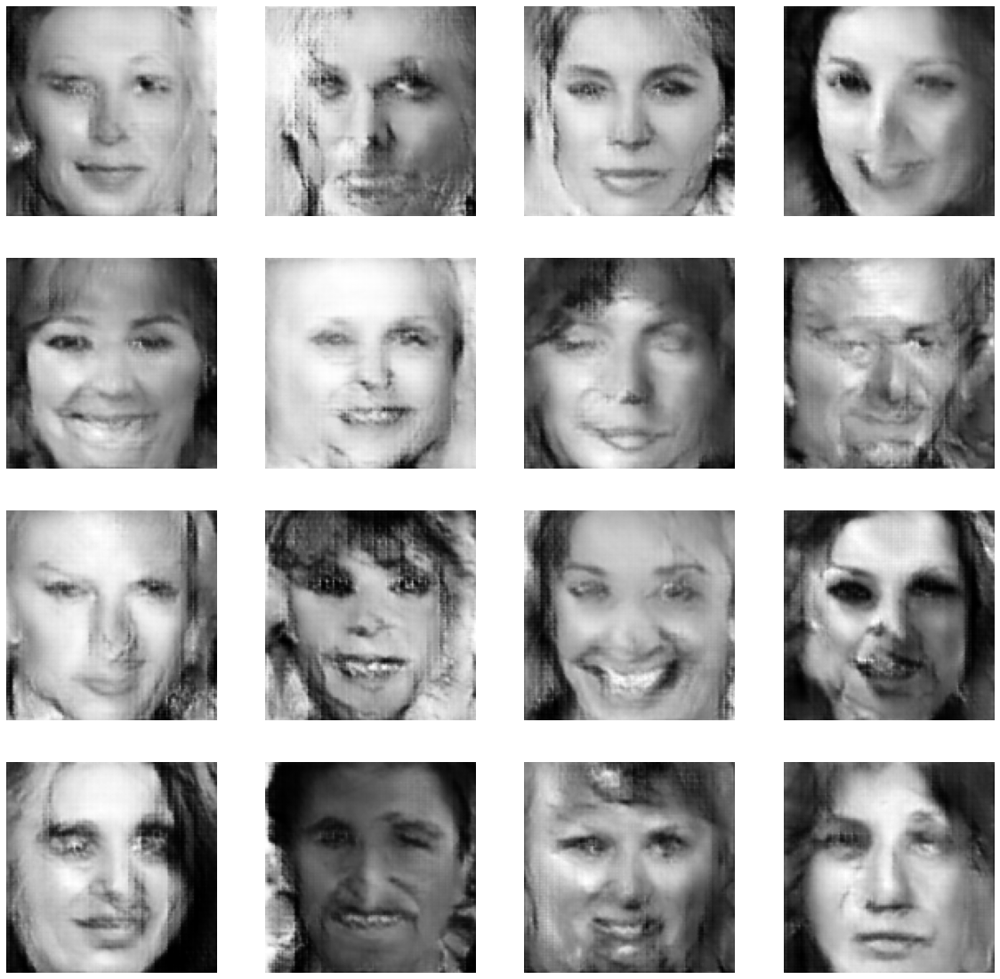

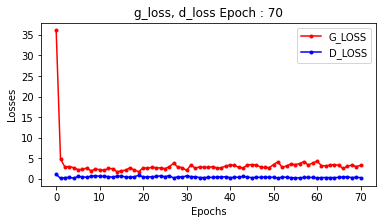

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

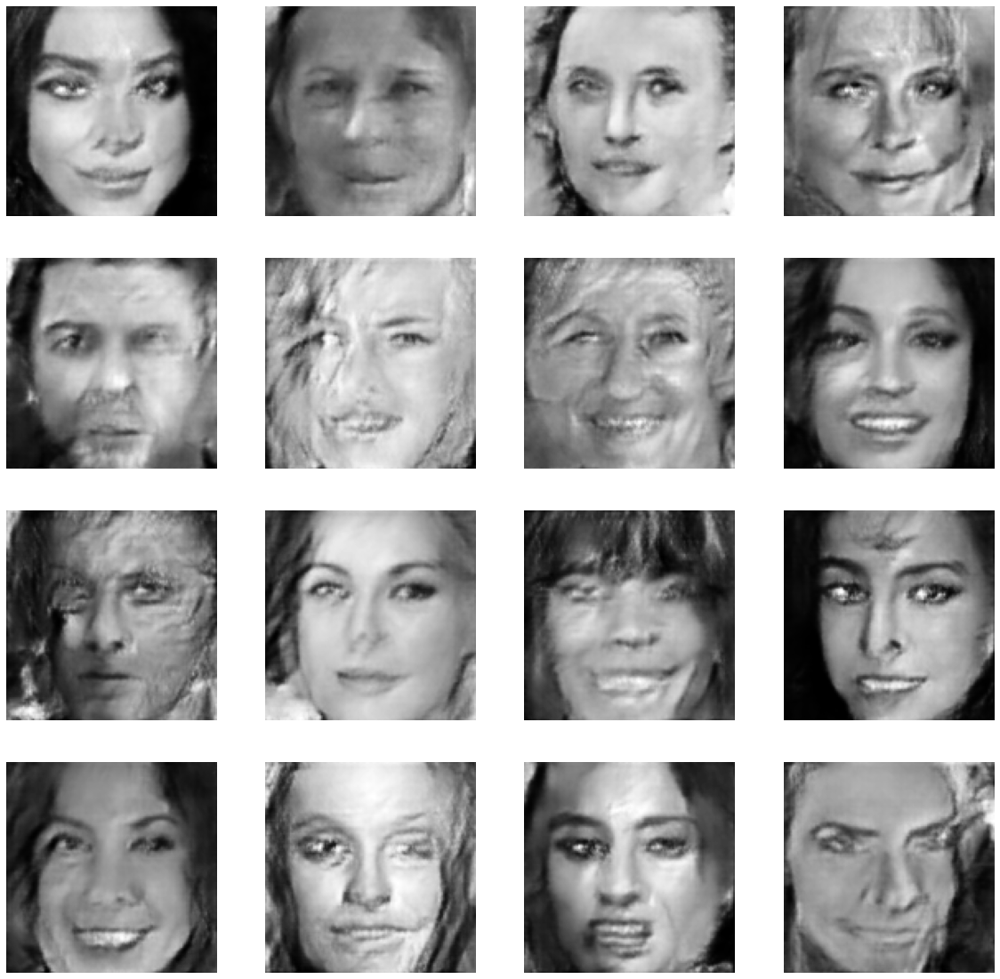

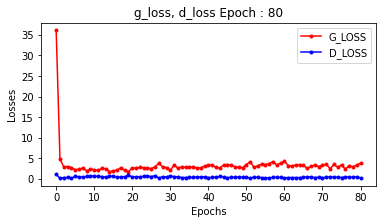

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

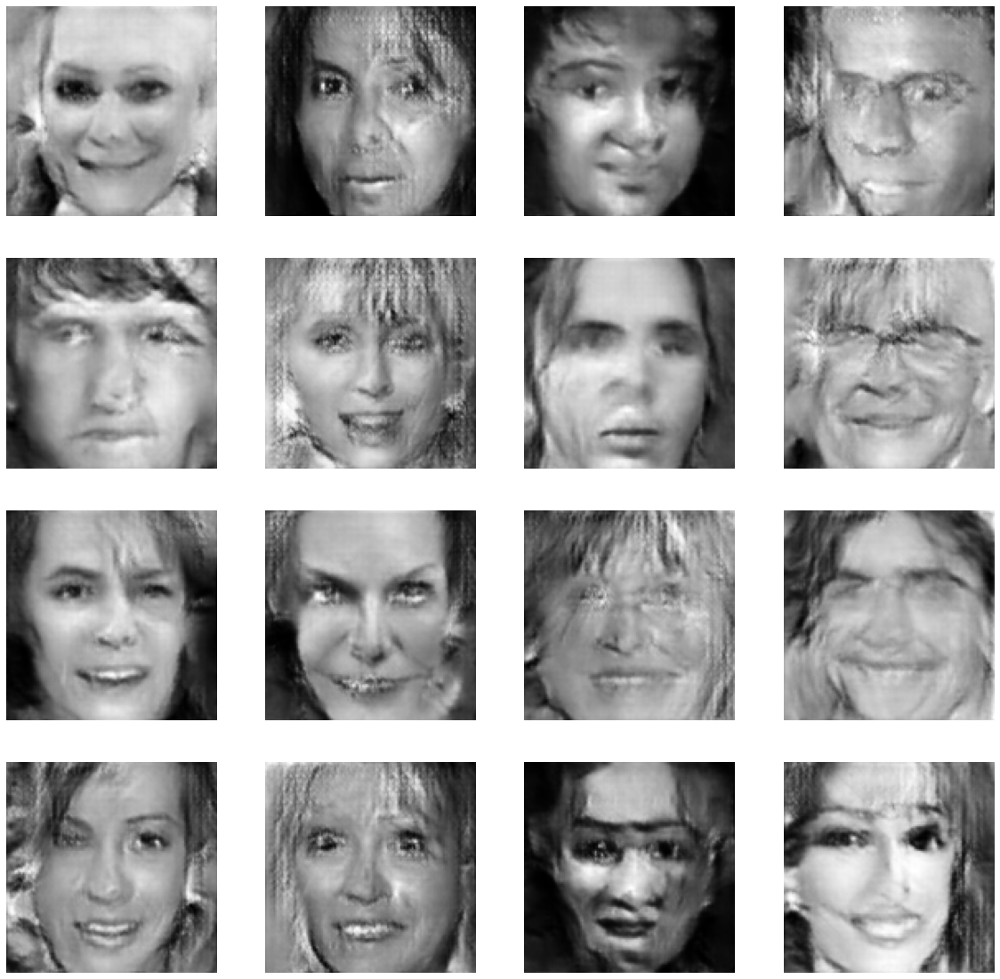

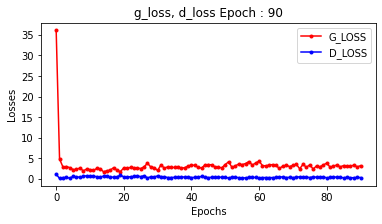

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

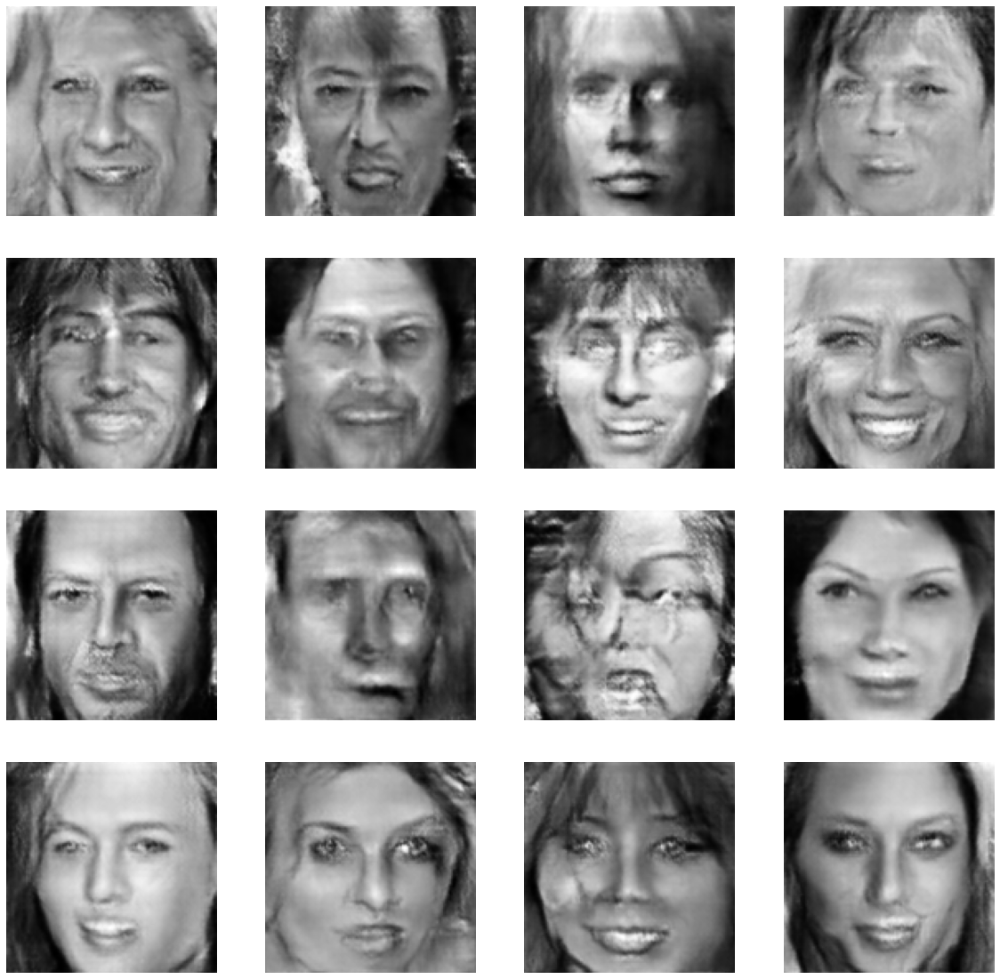

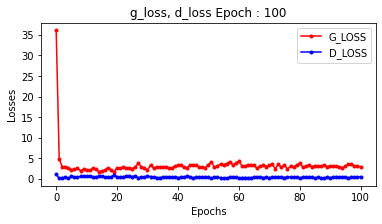

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

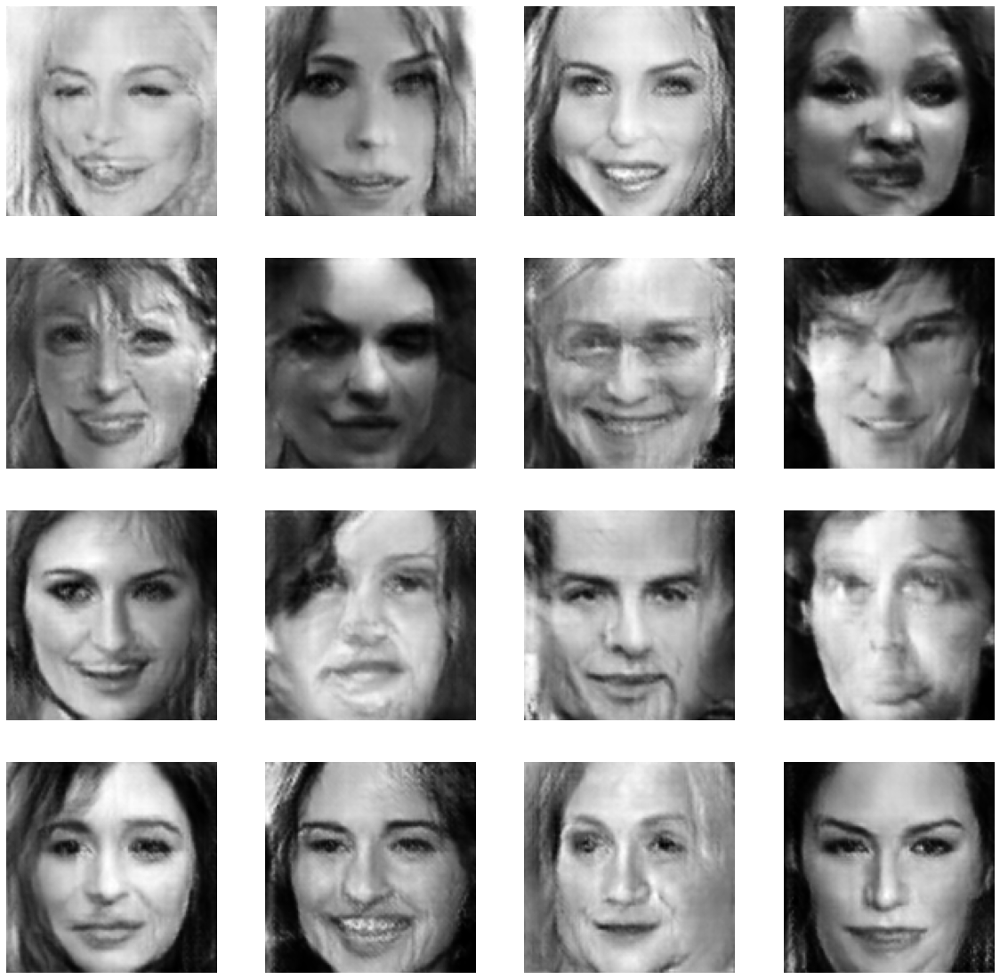

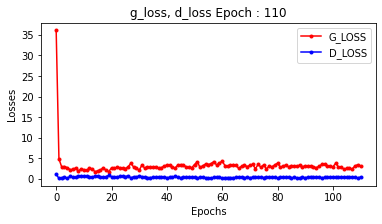

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

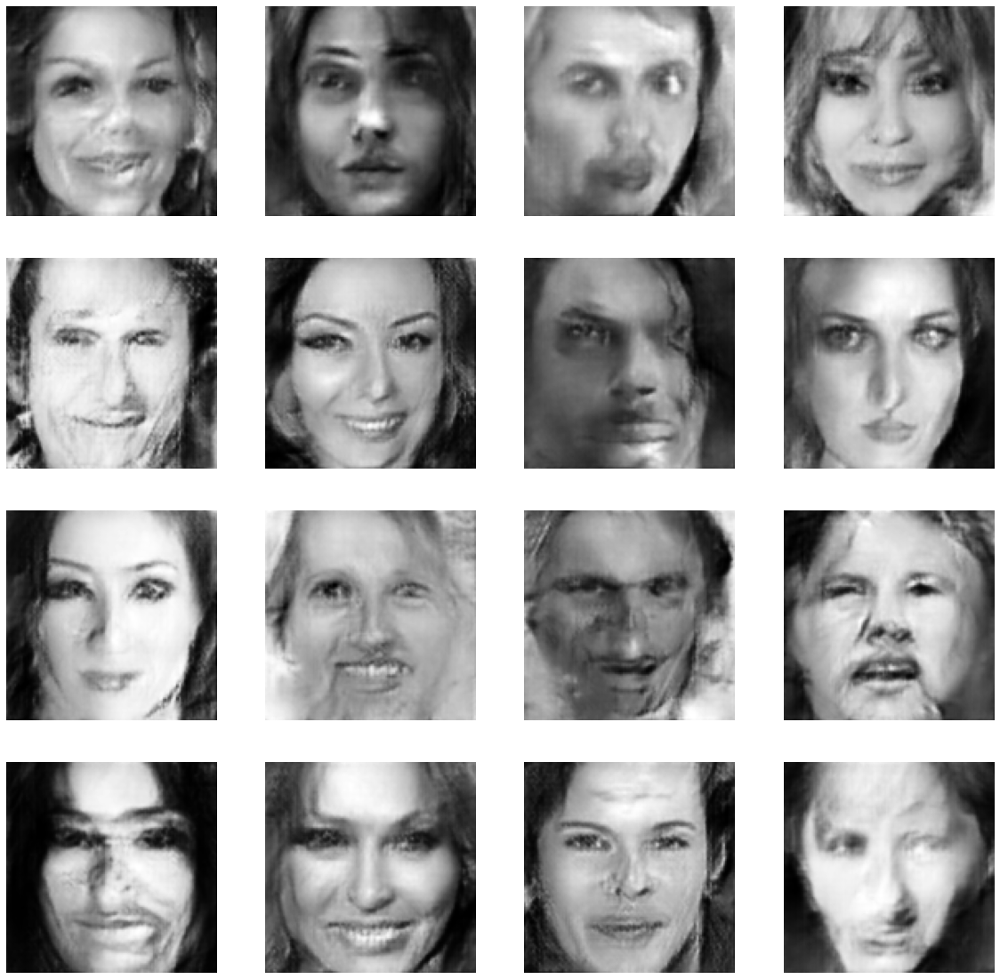

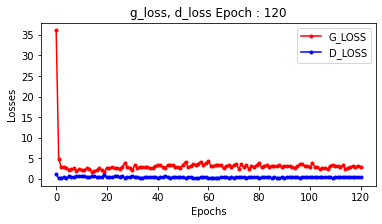

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

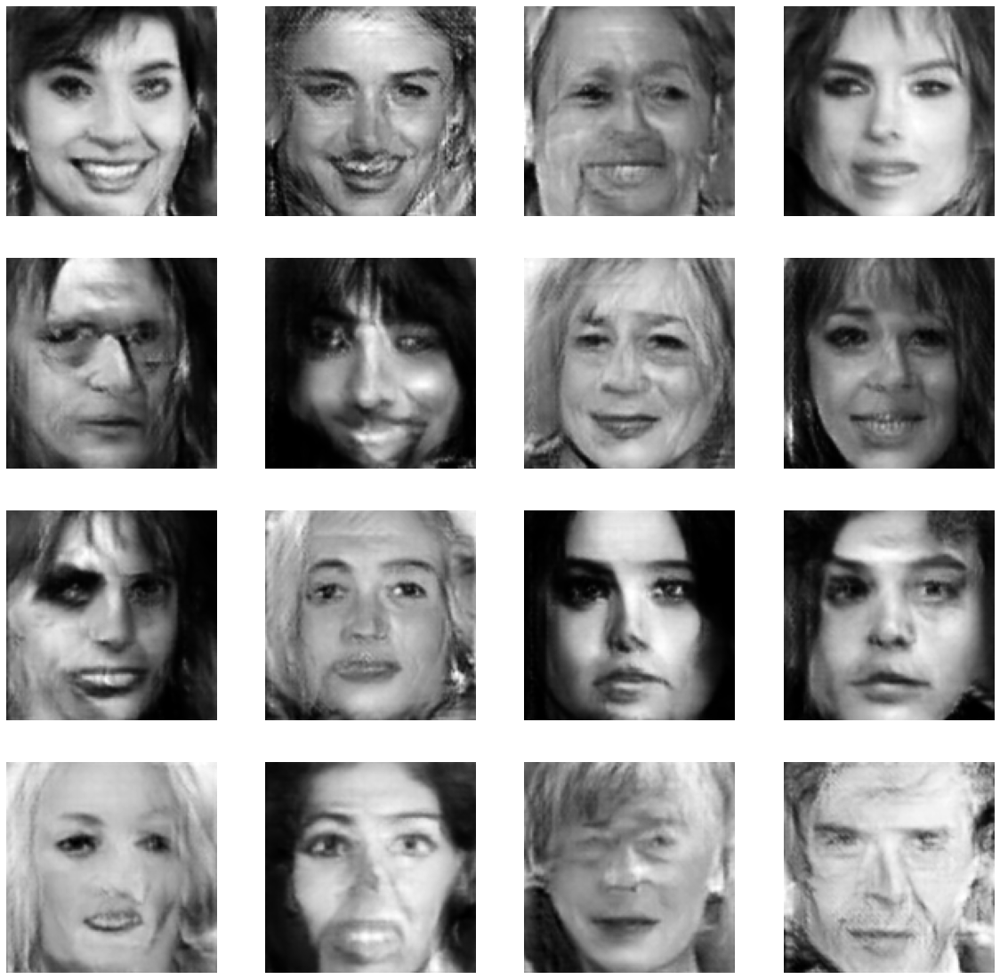

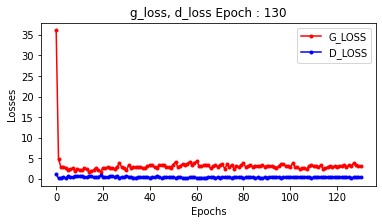

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

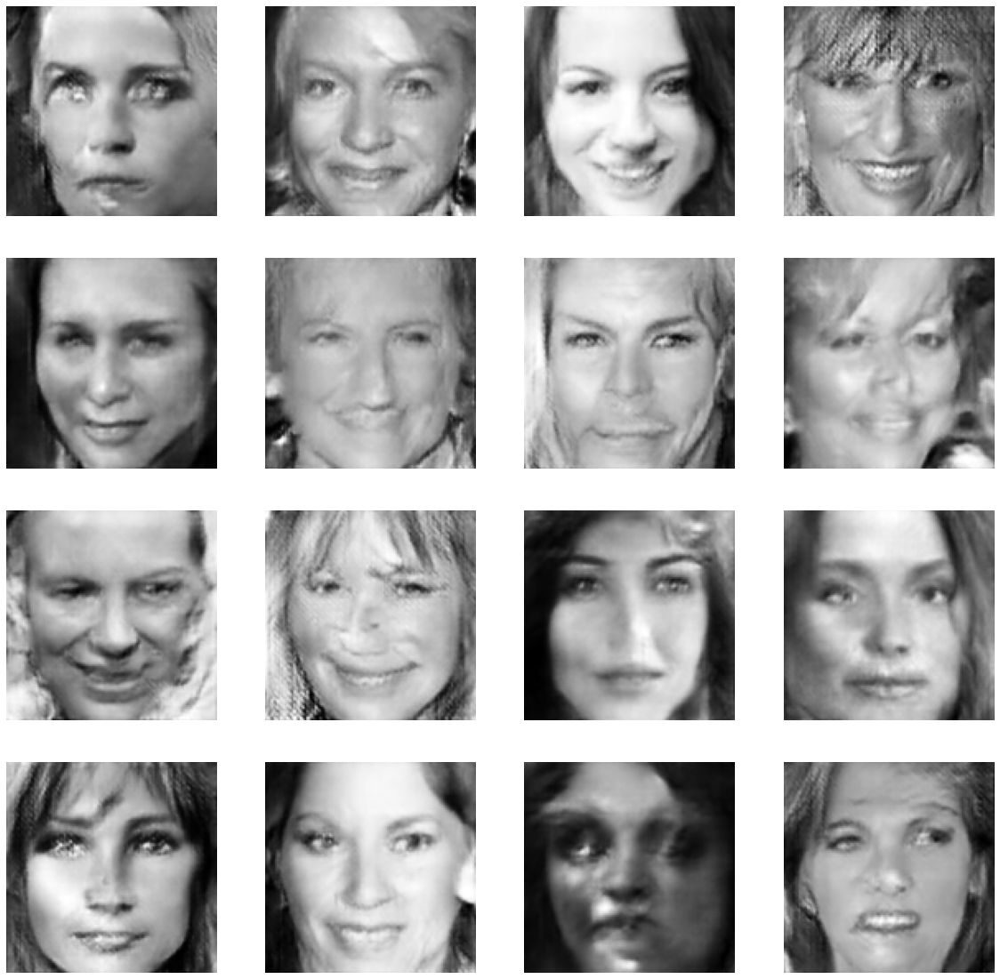

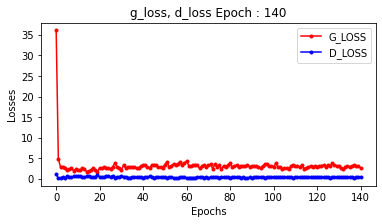

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

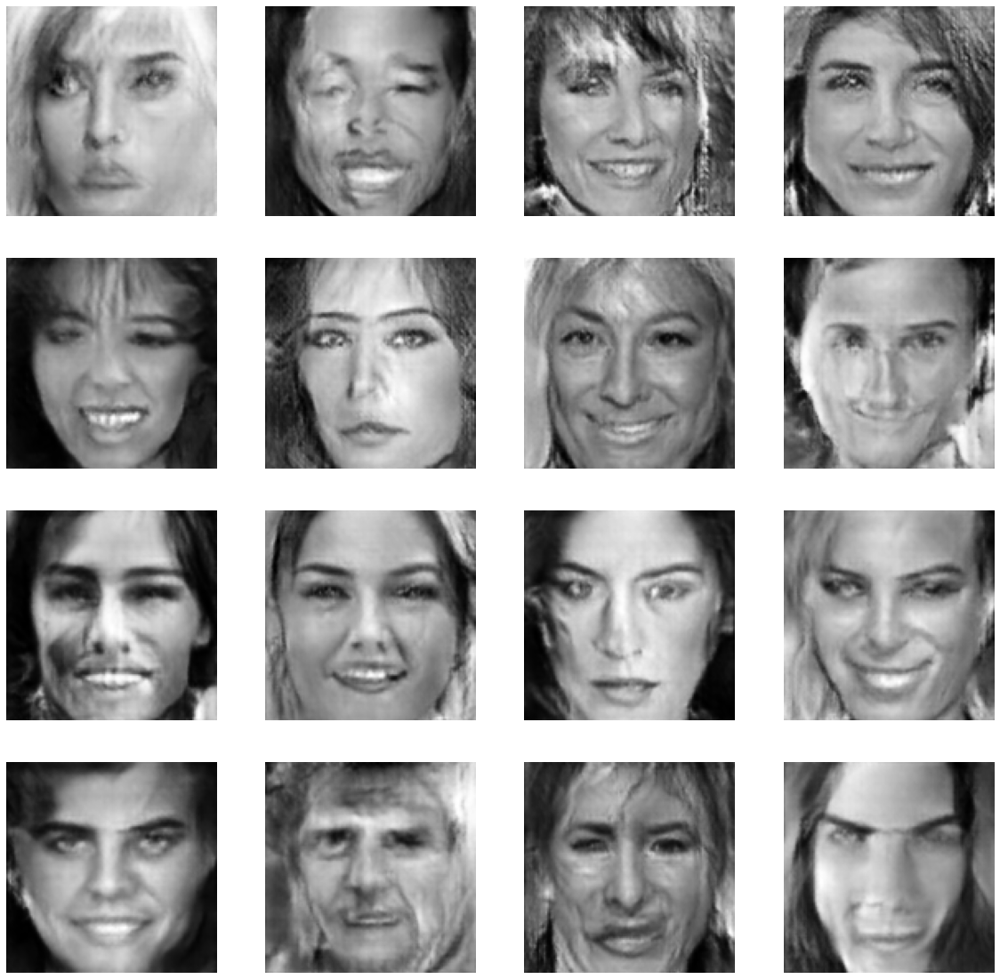

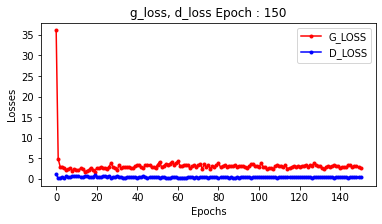

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

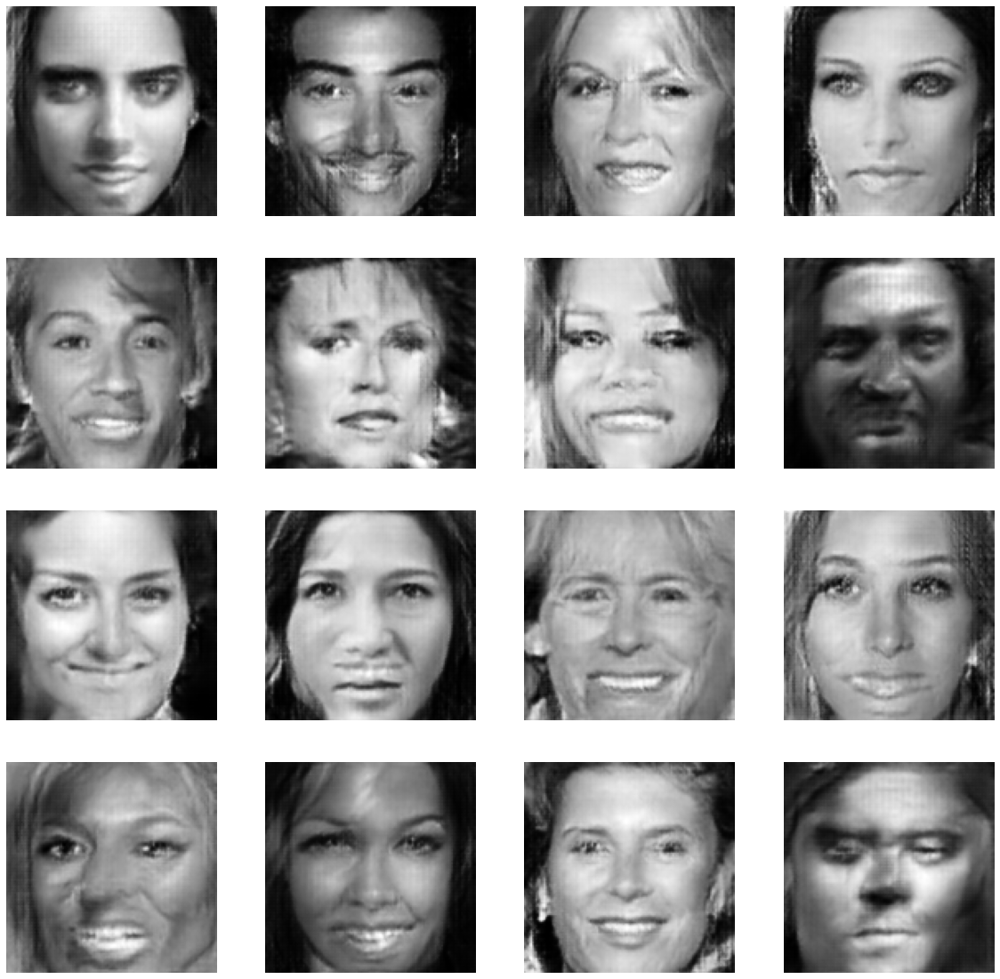

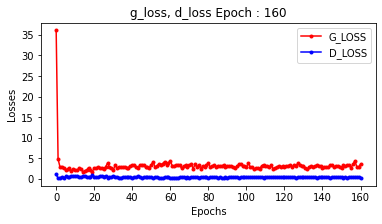

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

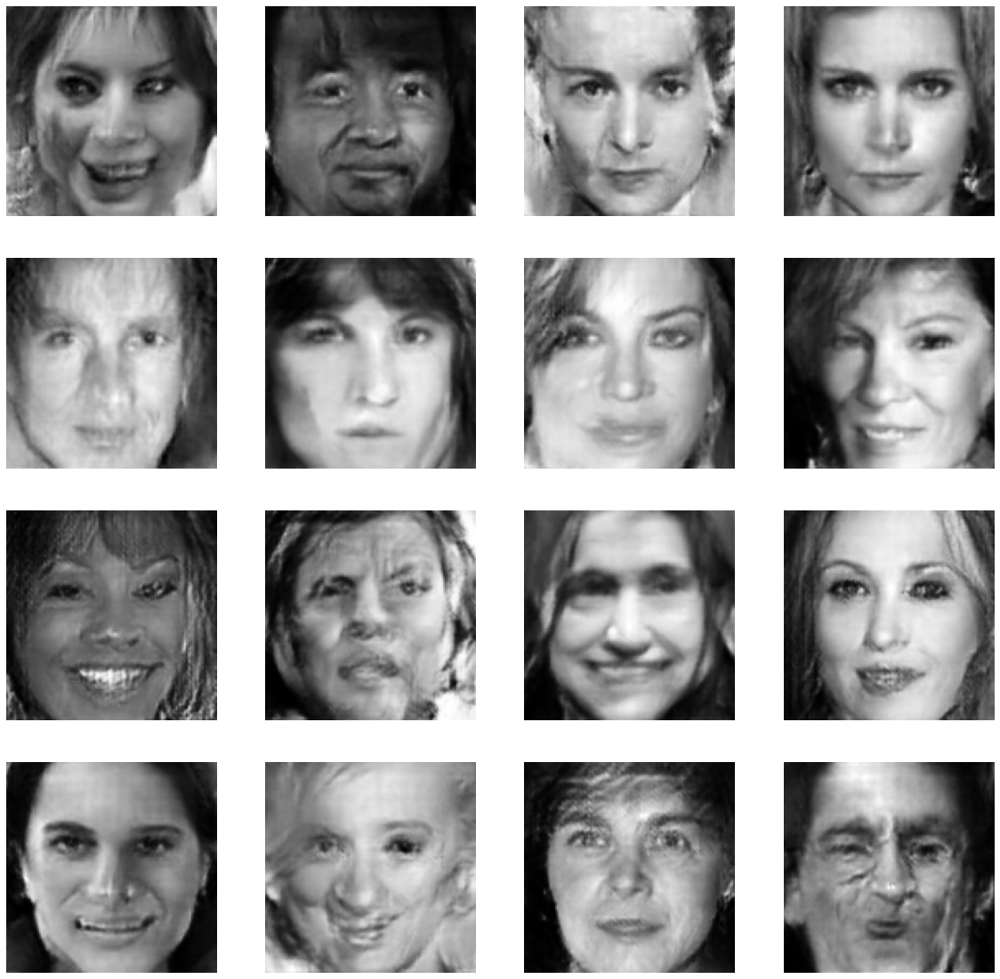

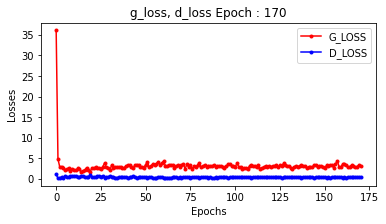

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

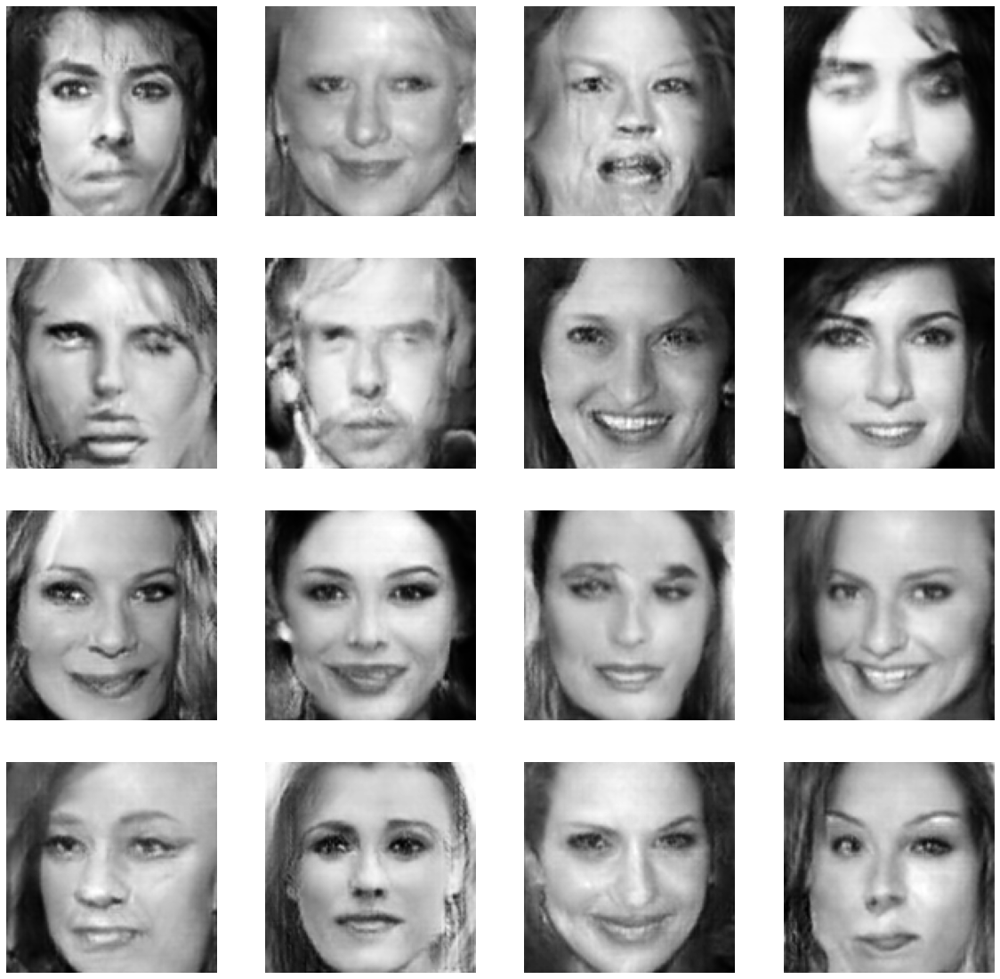

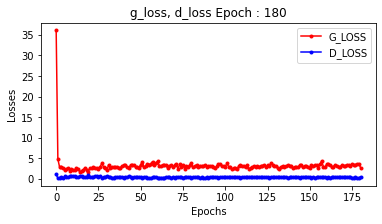

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

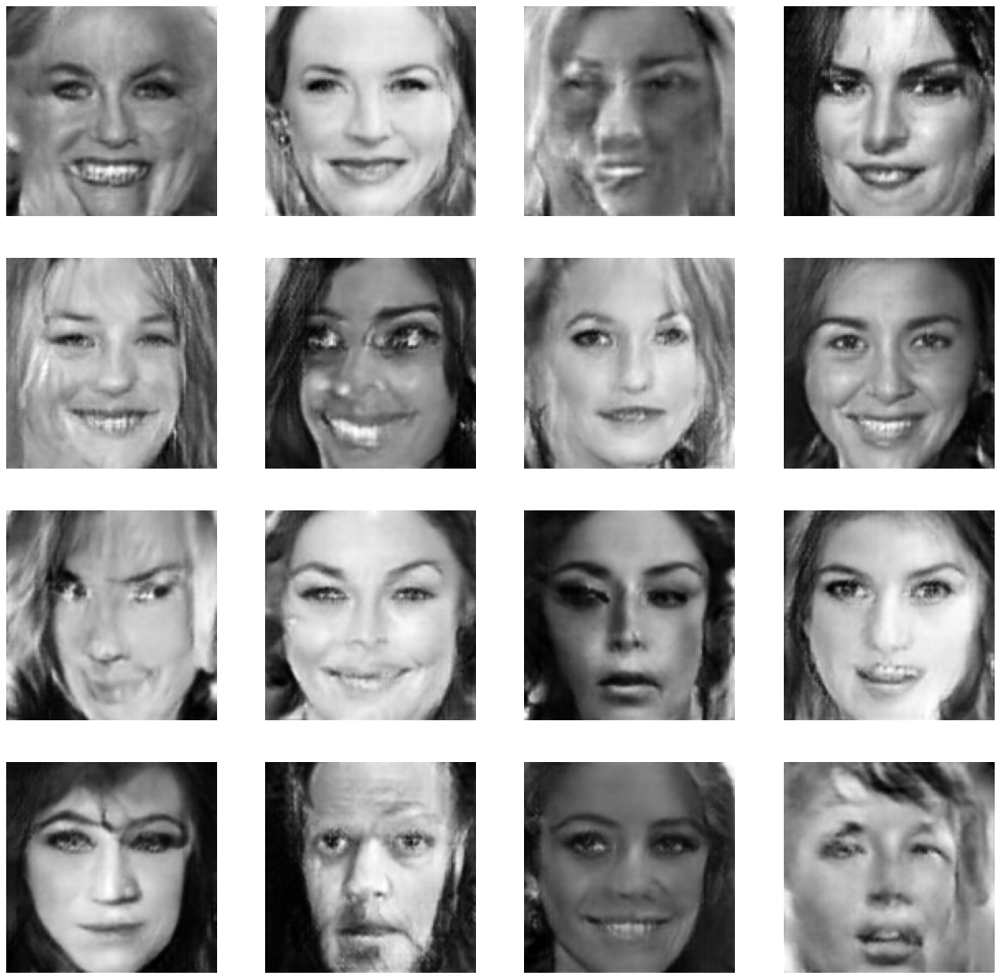

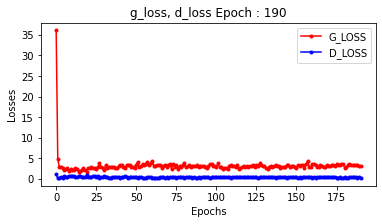

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

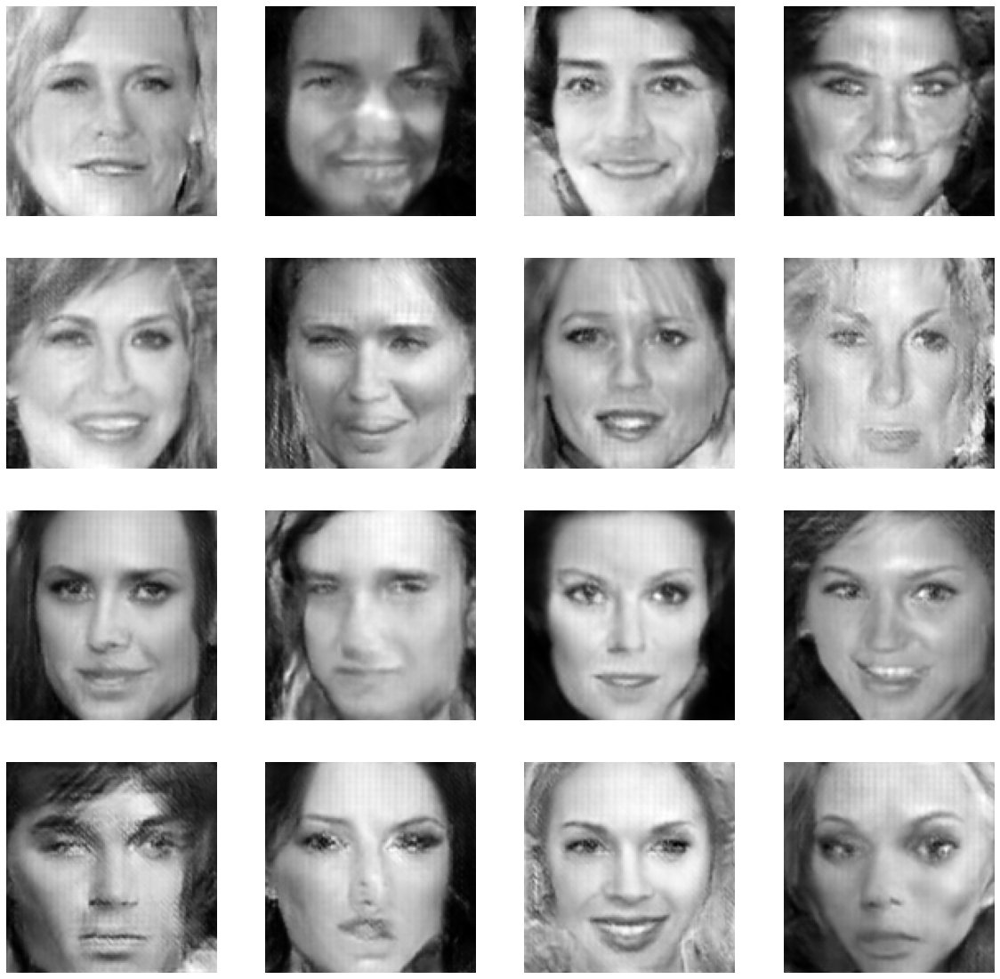

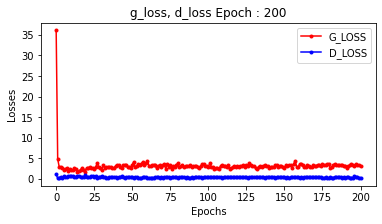

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

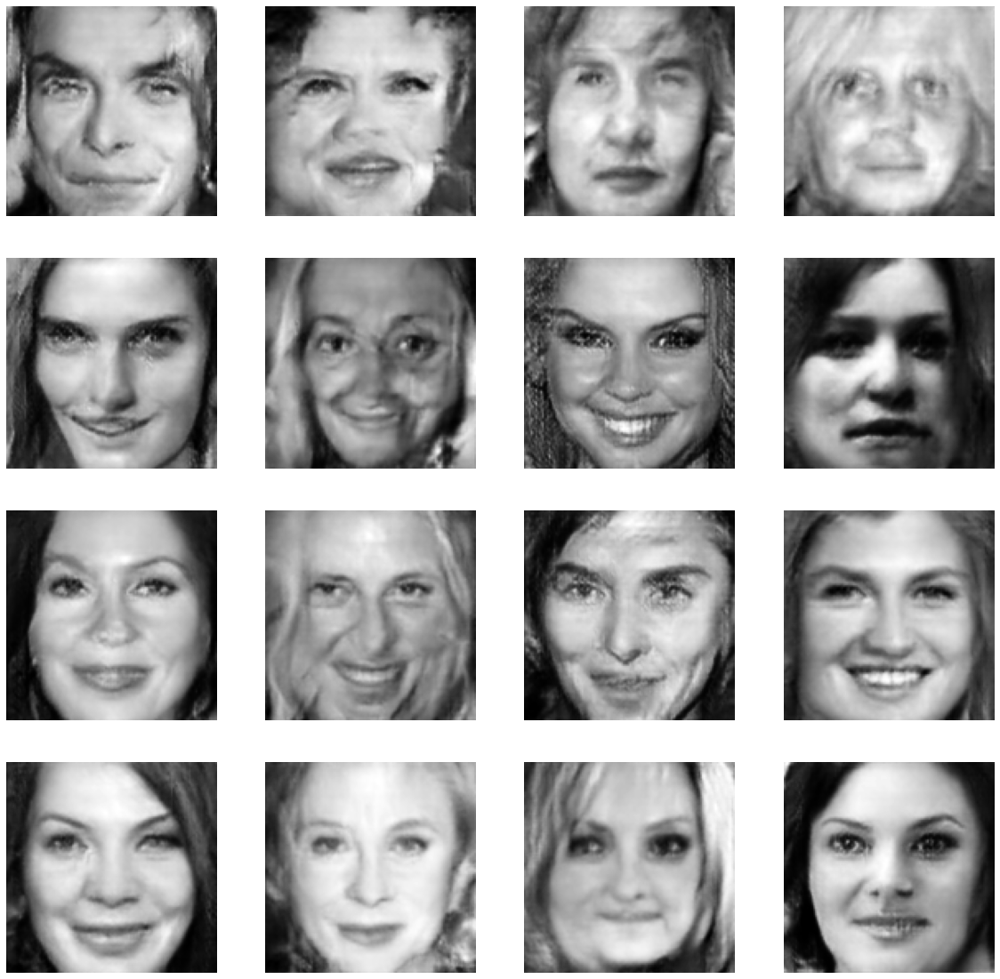

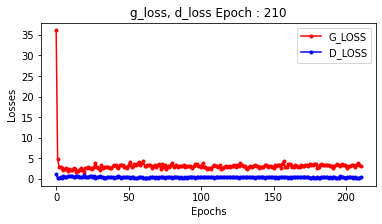

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

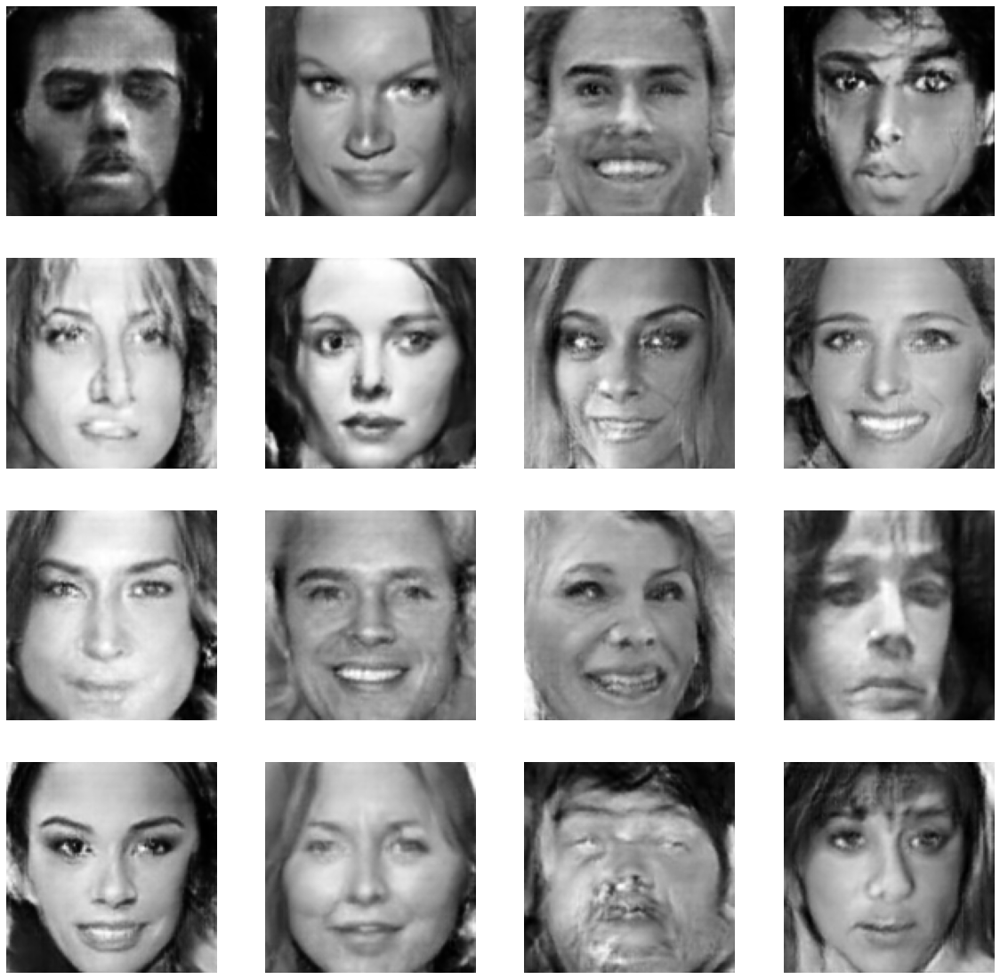

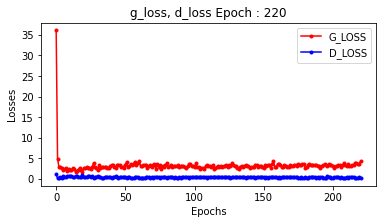

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

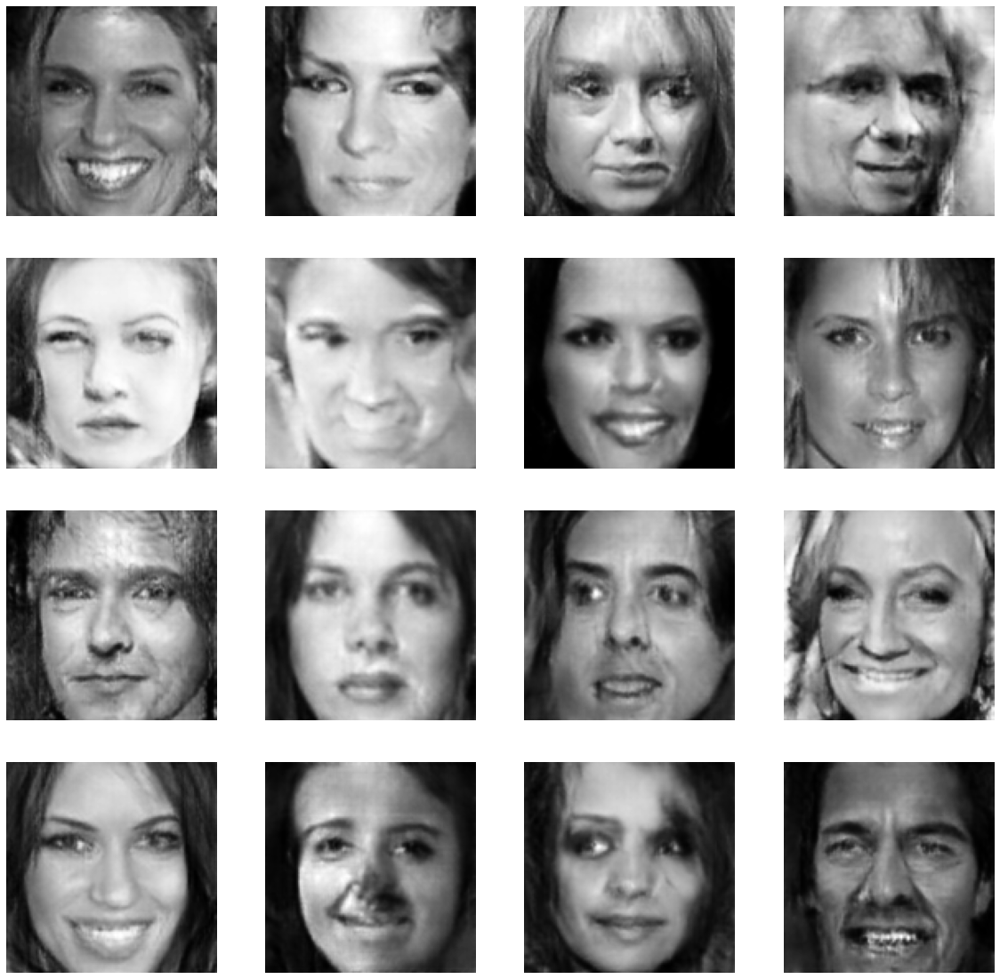

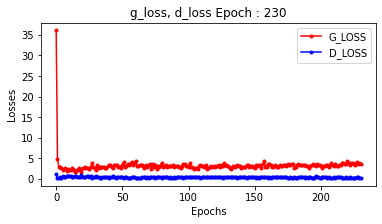

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

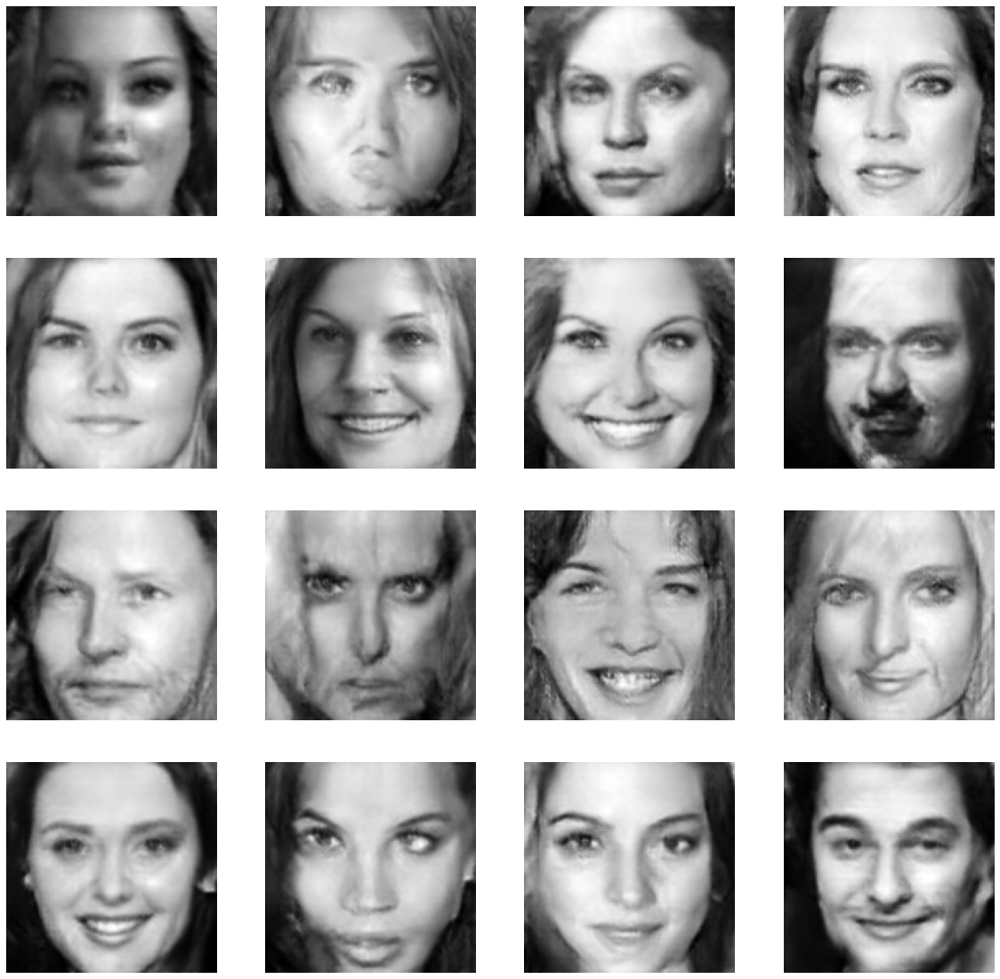

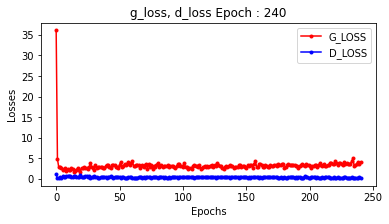

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

Train Step: 0it [00:00, ?it/s]

In [ ]:
g_losses = []
d_losses = []

# 학습 루프
for epoch in tqdm(range(EPOCHS), desc='Train Epoch'):
  start = time.time()
  
  # 학습 스탭
  for idx, real_images in tqdm(enumerate(train_dataset), desc='Train Step'):
    g_loss, d_loss = train_step(g_model, d_model, loss_function, g_optimizer, d_optimizer, learning_rate, real_images)

  # Loss값 저장
  g_losses.append(g_loss)
  d_losses.append(d_loss)
    
  # Loss 현황, Generator 모델 생성 성능 확인
  if (epoch % 10) == 0:
    generate_and_save_images(g_model, batch_size, latent_size, epoch)
    show_losses(g_losses, d_losses, epoch)

  if (epoch % 300) == 0:
    checkpoint.save(file_prefix = checkpoint_prefix)